In [1]:
import plotly.express as px
df = px.data.tips()
fig = px.box(df, y="total_bill")
fig.show()



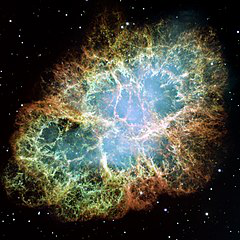

In [2]:
import plotly.express as px
from skimage import io
img = io.imread('https://upload.wikimedia.org/wikipedia/commons/thumb/0/00/Crab_Nebula.jpg/240px-Crab_Nebula.jpg')
fig = px.imshow(img)
fig.show()


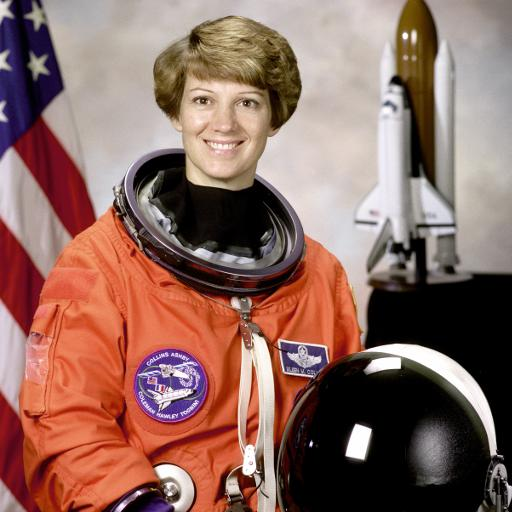

In [3]:
import plotly.express as px
from skimage import data
img = data.astronaut()
fig = px.imshow(img, binary_format="jpeg", binary_compression_level=0)
fig.show()

In [4]:
import plotly.express as px
from skimage import data
img = data.camera()
fig = px.imshow(img, color_continuous_scale='gray')
fig.update_layout(coloraxis_showscale=False)
fig.update_xaxes(showticklabels=False)
fig.update_yaxes(showticklabels=False)
fig.show()

In [5]:
import plotly.express as px
import plotly.graph_objects as go
from skimage import data
img = data.camera()
fig = px.imshow(img, color_continuous_scale='gray')
fig.add_trace(go.Contour(z=img, showscale=False,
                         contours=dict(start=0, end=70, size=70, coloring='lines'),
                         line_width=2))
fig.add_trace(go.Scatter(x=[230], y=[100], marker=dict(color='red', size=16)))
fig.show()

In [6]:
from plotly.subplots import make_subplots
from skimage import data
img = data.chelsea()
fig = make_subplots(1, 2)
# We use go.Image because subplots require traces, whereas px functions return a figure
fig.add_trace(go.Image(z=img), 1, 1)
for channel, color in enumerate(['red', 'green', 'blue']):
    fig.add_trace(go.Histogram(x=img[..., channel].ravel(), opacity=0.5,
                               marker_color=color, name='%s channel' %color), 1, 2)
fig.update_layout(height=400)
fig.show()


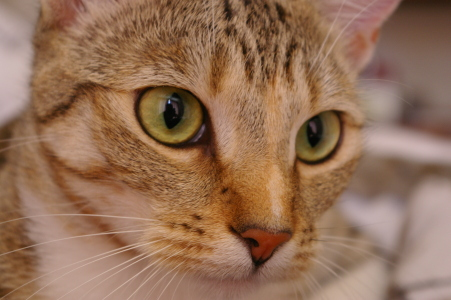

In [8]:
import plotly.express as px
from skimage import data
img = data.chelsea()
fig = px.imshow(img)
fig.add_annotation(
    x=0.5,
    y=0.9,
    text="Drag and draw annotations",
    xref="paper",
    yref="paper",
    showarrow=False,
    font_size=20, font_color='cyan')
# Shape defined programatically
fig.add_shape(
    type='rect',
    x0=230, x1=290, y0=230, y1=280,
    xref='x', yref='y',
    line_color='cyan'
)
# Define dragmode, newshape parameters, amd add modebar buttons
fig.update_layout(
    dragmode='drawrect',
    newshape=dict(line_color='cyan'))
fig.show(config={'modeBarButtonsToAdd':['drawline',
                                        'drawopenpath',
                                        'drawclosedpath',
                                        'drawcircle',
                                        'drawrect',
                                        'eraseshape'
                                       ]})


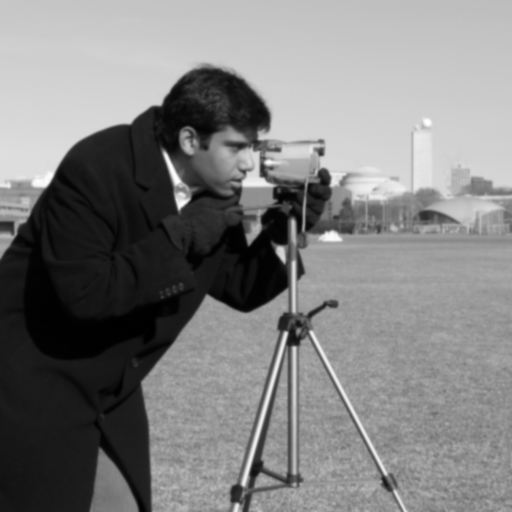
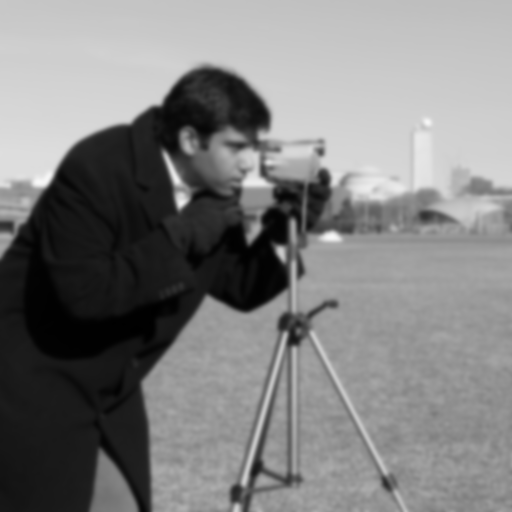
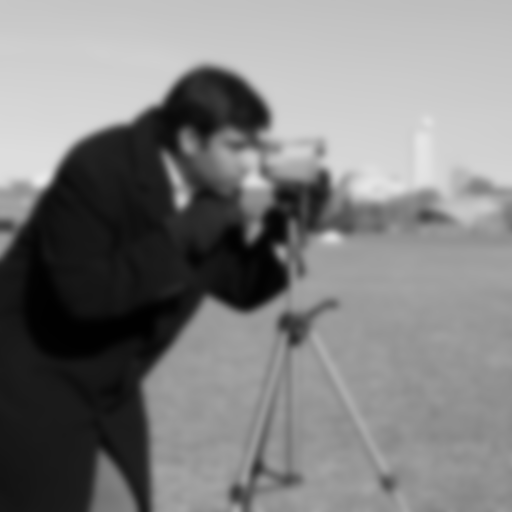

In [10]:
import plotly.express as px
import numpy as np
from skimage import data, filters, img_as_float
img = data.camera()
sigmas = [1, 2, 4]
img_sequence = [filters.gaussian(img, sigma=sigma) for sigma in sigmas]
fig = px.imshow(np.array(img_sequence), facet_col=0, binary_string=True,
                labels={'facet_col':'sigma'})
# Set facet titles
for i, sigma in enumerate(sigmas):
    fig.layout.annotations[i]['text'] = 'sigma = %d' %sigma
fig.show()

In [ ]:
import plotly.express as px
from skimage import io
data = io.imread("https://github.com/scikit-image/skimage-tutorials/raw/main/images/cells.tif")
img = data[25:40]
fig = px.imshow(img, animation_frame=0, binary_string=True, labels=dict(animation_frame="slice"))
fig.show()

In [ ]:
import plotly.express as px
import xarray as xr
# Load xarray from dataset included in the xarray tutorial
ds = xr.tutorial.open_dataset('air_temperature').air[:20]
fig = px.imshow(ds, animation_frame='time', zmin=220, zmax=300, color_continuous_scale='RdBu_r')
fig.show()

In [12]:
import plotly.graph_objects as go

import pandas as pd

# load dataset
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/volcano.csv")

# Create figure
fig = go.Figure()

# Add surface trace
fig.add_trace(go.Heatmap(z=df.values.tolist(), colorscale="Viridis"))

# Update plot sizing
fig.update_layout(
    width=800,
    height=900,
    autosize=False,
    margin=dict(t=100, b=0, l=0, r=0),
)

# Update 3D scene options
fig.update_scenes(
    aspectratio=dict(x=1, y=1, z=0.7),
    aspectmode="manual"
)

# Add drowdowns
# button_layer_1_height = 1.08
button_layer_1_height = 1.12
button_layer_2_height = 1.065

fig.update_layout(
    updatemenus=[
        dict(
            buttons=list([
                dict(
                    args=["colorscale", "Viridis"],
                    label="Viridis",
                    method="restyle"
                ),
                dict(
                    args=["colorscale", "Cividis"],
                    label="Cividis",
                    method="restyle"
                ),
                dict(
                    args=["colorscale", "Blues"],
                    label="Blues",
                    method="restyle"
                ),
                dict(
                    args=["colorscale", "Greens"],
                    label="Greens",
                    method="restyle"
                ),
            ]),
            type = "buttons",
            direction="right",
            pad={"r": 10, "t": 10},
            showactive=True,
            x=0.1,
            xanchor="left",
            y=button_layer_1_height,
            yanchor="top"
        ),
        dict(
            buttons=list([
                dict(
                    args=["reversescale", False],
                    label="False",
                    method="restyle"
                ),
                dict(
                    args=["reversescale", True],
                    label="True",
                    method="restyle"
                )
            ]),
            type = "buttons",
            direction="right",
            pad={"r": 10, "t": 10},
            showactive=True,
            x=0.13,
            xanchor="left",
            y=button_layer_2_height,
            yanchor="top"
        ),
        dict(
            buttons=list([
                dict(
                    args=[{"contours.showlines": False, "type": "contour"}],
                    label="Hide lines",
                    method="restyle"
                ),
                dict(
                    args=[{"contours.showlines": True, "type": "contour"}],
                    label="Show lines",
                    method="restyle"
                ),
            ]),
            type = "buttons",
            direction="right",
            pad={"r": 10, "t": 10},
            showactive=True,
            x=0.5,
            xanchor="left",
            y=button_layer_2_height,
            yanchor="top"
        ),
    ]
)

fig.update_layout(
    annotations=[
        dict(text="colorscale", x=0, xref="paper", y=1.1, yref="paper",
                             align="left", showarrow=False),
        dict(text="Reverse<br>Colorscale", x=0, xref="paper", y=1.06,
                             yref="paper", showarrow=False),
        dict(text="Lines", x=0.47, xref="paper", y=1.045, yref="paper",
                             showarrow=False)
    ])

fig.show()

In [13]:
import plotly.graph_objects as go

# Generate dataset
import numpy as np
np.random.seed(1)

x0 = np.random.normal(2, 0.4, 400)
y0 = np.random.normal(2, 0.4, 400)
x1 = np.random.normal(3, 0.6, 600)
y1 = np.random.normal(6, 0.4, 400)
x2 = np.random.normal(4, 0.2, 200)
y2 = np.random.normal(4, 0.4, 200)

# Create figure
fig = go.Figure()

# Add traces
fig.add_trace(
    go.Scatter(
        x=x0,
        y=y0,
        mode="markers",
        marker=dict(color="DarkOrange")
    )
)

fig.add_trace(
    go.Scatter(
        x=x1,
        y=y1,
        mode="markers",
        marker=dict(color="Crimson")
    )
)

fig.add_trace(
    go.Scatter(
        x=x2,
        y=y2,
        mode="markers",
        marker=dict(color="RebeccaPurple")
    )
)

# Add buttons that add shapes
cluster0 = [dict(type="circle",
                            xref="x", yref="y",
                            x0=min(x0), y0=min(y0),
                            x1=max(x0), y1=max(y0),
                            line=dict(color="DarkOrange"))]
cluster1 = [dict(type="circle",
                            xref="x", yref="y",
                            x0=min(x1), y0=min(y1),
                            x1=max(x1), y1=max(y1),
                            line=dict(color="Crimson"))]
cluster2 = [dict(type="circle",
                            xref="x", yref="y",
                            x0=min(x2), y0=min(y2),
                            x1=max(x2), y1=max(y2),
                            line=dict(color="RebeccaPurple"))]

fig.update_layout(
    updatemenus=[
        dict(
            type="buttons",
            buttons=[
                dict(label="None",
                     method="relayout",
                     args=["shapes", []]),
                dict(label="Cluster 0",
                     method="relayout",
                     args=["shapes", cluster0]),
                dict(label="Cluster 1",
                     method="relayout",
                     args=["shapes", cluster1]),
                dict(label="Cluster 2",
                     method="relayout",
                     args=["shapes", cluster2]),
                dict(label="All",
                     method="relayout",
                     args=["shapes", cluster0 + cluster1 + cluster2])
            ],
        )
    ]
)

# Update remaining layout properties
fig.update_layout(
    title_text="Highlight Clusters",
    showlegend=False,
)

fig.show()

In [14]:
import plotly.graph_objects as go

import pandas as pd

# Load dataset
df = pd.read_csv(
    "https://raw.githubusercontent.com/plotly/datasets/master/finance-charts-apple.csv")
df.columns = [col.replace("AAPL.", "") for col in df.columns]

# Initialize figure
fig = go.Figure()

# Add Traces

fig.add_trace(
    go.Scatter(x=list(df.index),
               y=list(df.High),
               name="High",
               line=dict(color="#33CFA5")))

fig.add_trace(
    go.Scatter(x=list(df.index),
               y=[df.High.mean()] * len(df.index),
               name="High Average",
               visible=False,
               line=dict(color="#33CFA5", dash="dash")))

fig.add_trace(
    go.Scatter(x=list(df.index),
               y=list(df.Low),
               name="Low",
               line=dict(color="#F06A6A")))

fig.add_trace(
    go.Scatter(x=list(df.index),
               y=[df.Low.mean()] * len(df.index),
               name="Low Average",
               visible=False,
               line=dict(color="#F06A6A", dash="dash")))

# Add Annotations and Buttons
high_annotations = [dict(x="2016-03-01",
                         y=df.High.mean(),
                         xref="x", yref="y",
                         text="High Average:<br> %.2f" % df.High.mean(),
                         ax=0, ay=-40),
                    dict(x=df.High.idxmax(),
                         y=df.High.max(),
                         xref="x", yref="y",
                         text="High Max:<br> %.2f" % df.High.max(),
                         ax=0, ay=-40)]
low_annotations = [dict(x="2015-05-01",
                        y=df.Low.mean(),
                        xref="x", yref="y",
                        text="Low Average:<br> %.2f" % df.Low.mean(),
                        ax=-40, ay=40),
                   dict(x=df.High.idxmin(),
                        y=df.Low.min(),
                        xref="x", yref="y",
                        text="Low Min:<br> %.2f" % df.Low.min(),
                        ax=0, ay=40)]

fig.update_layout(
    updatemenus=[
        dict(
            type="buttons",
            direction="right",
            active=0,
            x=0.57,
            y=1.2,
            buttons=list([
                dict(label="None",
                     method="update",
                     args=[{"visible": [True, False, True, False]},
                           {"title": "Yahoo",
                            "annotations": []}]),
                dict(label="High",
                     method="update",
                     args=[{"visible": [True, True, False, False]},
                           {"title": "Yahoo High",
                            "annotations": high_annotations}]),
                dict(label="Low",
                     method="update",
                     args=[{"visible": [False, False, True, True]},
                           {"title": "Yahoo Low",
                            "annotations": low_annotations}]),
                dict(label="Both",
                     method="update",
                     args=[{"visible": [True, True, True, True]},
                           {"title": "Yahoo",
                            "annotations": high_annotations + low_annotations}]),
            ]),
        )
    ])

# Set title
fig.update_layout(
    title_text="Yahoo",
    xaxis_domain=[0.05, 1.0]
)

fig.show()